In [26]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [27]:
font = {'family': 'monospace', 'weight': 'medium', 'size': 13}

plt.rc('font', **font)
plt.rc('figure', figsize=(14, 8), dpi=700)

# **GOAL**

Predict the **MEDIAN HOUSE VALUE** in a given district using the provided dataset

### MACHINE LEARNING DESIGN

- **targets/label**: *Supervised Learning*

- **changing dataset ? - NO**: *Batch/offline learning*

- **too large dataset?-NO**: *not out-of-core learning*

In [28]:
# get the dataset

housing = pd.read_csv("../datasets/housing.csv")

housing.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


In [29]:
# get the info of the dataset

housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


### **OBSERVATIONS - 1**

- All Attributes are numerical except the ***ocean_proximity*** attribute

- There are missing values in the ***total_bedrooms*** column

---

array([[<Axes: title={'center': 'longitude'}>,
        <Axes: title={'center': 'latitude'}>,
        <Axes: title={'center': 'housing_median_age'}>],
       [<Axes: title={'center': 'total_rooms'}>,
        <Axes: title={'center': 'total_bedrooms'}>,
        <Axes: title={'center': 'population'}>],
       [<Axes: title={'center': 'households'}>,
        <Axes: title={'center': 'median_income'}>,
        <Axes: title={'center': 'median_house_value'}>]], dtype=object)

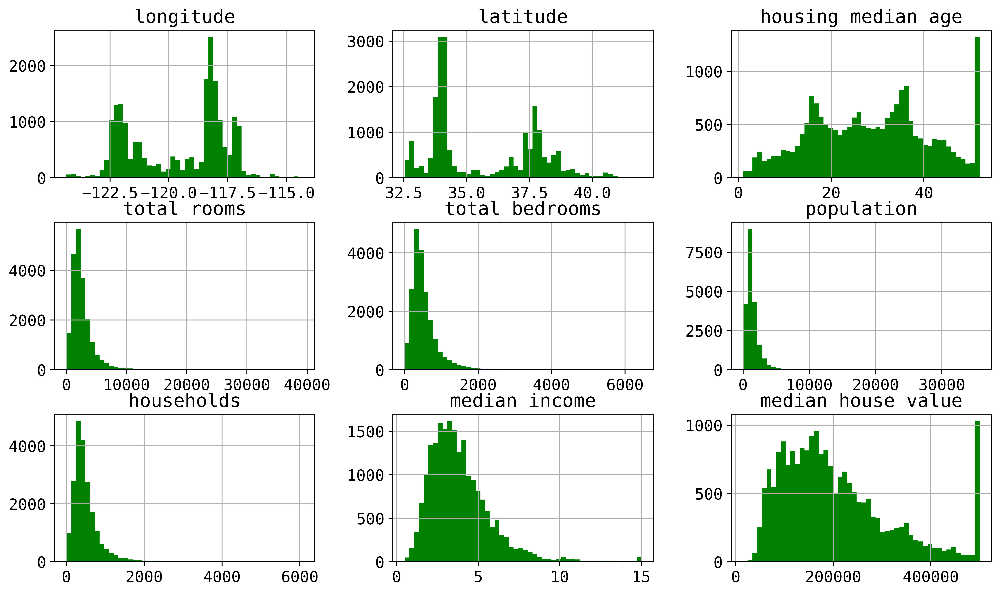

In [30]:
# visualize the dataset distribution

housing.hist(bins=50, grid=True, color='green')

### **OBSERVATION - 2**

- The following attributes (*total_rooms, total_bedrooms, population, housholds, median_income, median_house_value*) have their data skewed to the right, indicating that there are outliers in th dataset on the high side

- The **median_income** values have been scaled down by **ten-thousand dollars**, this indicates that the real value is ten-thousand times the given values

---

### TRAINING & TEST DATASET

We want the test set to be representative of the entire dataset, so as to avoid sampling bias which may result in poor generalization. Hence, we use stratified sampling.

However, we must decide on which attribute is the most correlated with the target we we want to predict, and then used that attribute to create a stratified sampling


In [31]:
# get the correlation of all attributes with respect to target

# get only numerical attributes
housing_num = housing.select_dtypes(np.number)

housing_num.columns

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value'],
      dtype='object')

In [32]:
# get the correlation matrix

housing_corr = housing_num.corr('pearson')

housing_corr['median_house_value'].sort_values(ascending=False)

median_house_value    1.000000
median_income         0.688075
total_rooms           0.134153
housing_median_age    0.105623
households            0.065843
total_bedrooms        0.049686
population           -0.024650
longitude            -0.045967
latitude             -0.144160
Name: median_house_value, dtype: float64

### **OBSERVATION - 3**

- *median_income* is more correlated with the target attribute.

- how do we stratify the values in the *media_income* column such that the resulting category is not too large?

In [33]:
housing_num.median_income.describe()

count    20640.000000
mean         3.870671
std          1.899822
min          0.499900
25%          2.563400
50%          3.534800
75%          4.743250
max         15.000100
Name: median_income, dtype: float64

<Axes: ylabel='Frequency'>

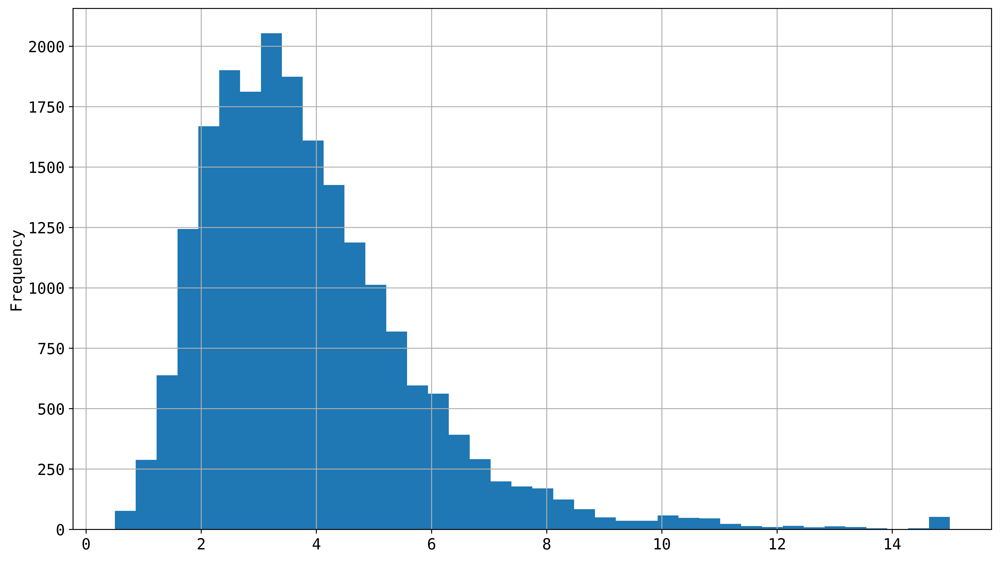

In [34]:
# visualize the median_income 

housing_num.median_income.plot.hist(bins=40, grid=True)

In [35]:
# subdivide into 

bins = [0., 1.5, 3.0, 4.5, 6.0, np.inf]

housing_num['income_cat'] = pd.cut(housing_num["median_income"],
                                   bins=bins, labels=[1, 2, 3, 4, 5])

housing_num.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,income_cat
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,5
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,5
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,5
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,4
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,3


In [36]:
# get the ratio of the category in the dataset

housing_num.income_cat.value_counts().sort_values(ascending=False)/ len(housing_num)

income_cat
3    0.350581
2    0.318847
4    0.176308
5    0.114438
1    0.039826
Name: count, dtype: float64

Split the dataset into a test set representative of the dataset in order to avoid sampling bias

In [37]:
from sklearn.model_selection import train_test_split

In [38]:
# use all the dataset instead of removing the non-numnerical attributes; as was done above

bins = [0., 1.5, 3.0, 4.5, 6.0, np.inf]

housing['income_cat'] = pd.cut(housing["median_income"],
                                   bins=bins, labels=[1, 2, 3, 4, 5])

In [39]:
# get the test dataset using this category

train_set, test_set = train_test_split(housing, test_size=0.2, stratify=housing["income_cat"], shuffle=True)

print(len(train_set), len(test_set))

16512 4128


We want to confirm that the resulting test set is representative of the entire dataset so as to avoid sampling bias

In [40]:
# get the ratio and compare for any sample bias

test_set.income_cat.value_counts().sort_values(ascending=False) / len(test_set)

income_cat
3    0.350533
2    0.318798
4    0.176357
5    0.114341
1    0.039971
Name: count, dtype: float64

### **EXPLORATORY DATA ANALYSIS - EDA**

We can start to explore the training set now

In [41]:
# get a copy of the training set

housing = train_set.copy()

<Axes: xlabel='longitude', ylabel='latitude'>

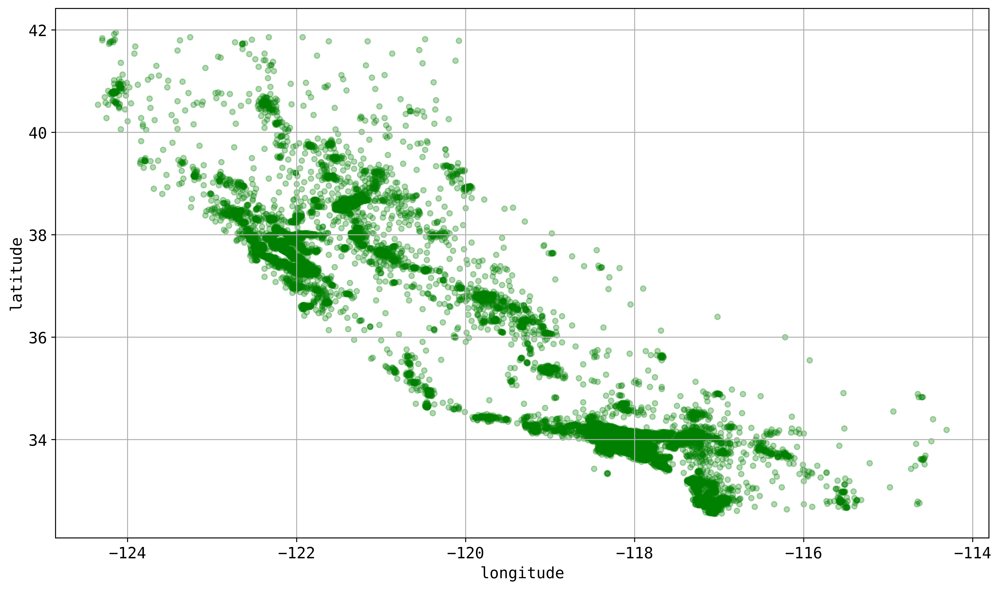

In [42]:
# visualise the geographical data

housing.plot(kind='scatter', x='longitude', y='latitude', alpha=0.3, color='green', grid=True)

<Axes: xlabel='longitude', ylabel='latitude'>

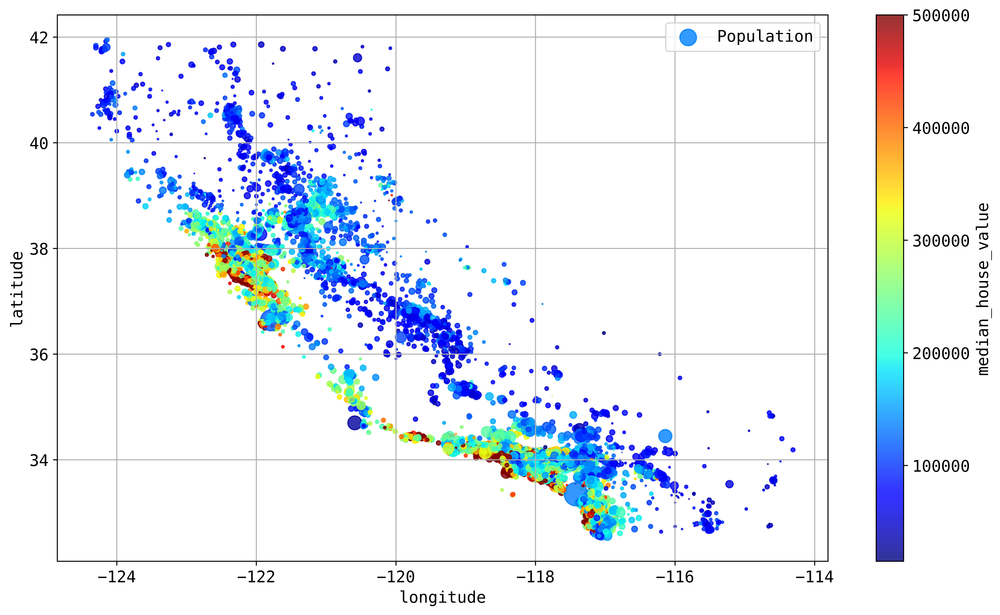

In [43]:
# add the population and households

housing.plot(
    kind='scatter',
    x='longitude',
    y='latitude',
    s=housing['population'] / 100,
    label='Population',
    c='median_house_value',
    colorbar=True,
    cmap='jet',
    grid=True,
    alpha=0.8, 
    legend=True, 
    sharex=False)

In [44]:
from pandas.plotting import scatter_matrix

array([[<Axes: xlabel='median_income', ylabel='median_income'>,
        <Axes: xlabel='total_rooms', ylabel='median_income'>,
        <Axes: xlabel='median_house_value', ylabel='median_income'>,
        <Axes: xlabel='housing_median_age', ylabel='median_income'>],
       [<Axes: xlabel='median_income', ylabel='total_rooms'>,
        <Axes: xlabel='total_rooms', ylabel='total_rooms'>,
        <Axes: xlabel='median_house_value', ylabel='total_rooms'>,
        <Axes: xlabel='housing_median_age', ylabel='total_rooms'>],
       [<Axes: xlabel='median_income', ylabel='median_house_value'>,
        <Axes: xlabel='total_rooms', ylabel='median_house_value'>,
        <Axes: xlabel='median_house_value', ylabel='median_house_value'>,
        <Axes: xlabel='housing_median_age', ylabel='median_house_value'>],
       [<Axes: xlabel='median_income', ylabel='housing_median_age'>,
        <Axes: xlabel='total_rooms', ylabel='housing_median_age'>,
        <Axes: xlabel='median_house_value', ylabel='housi

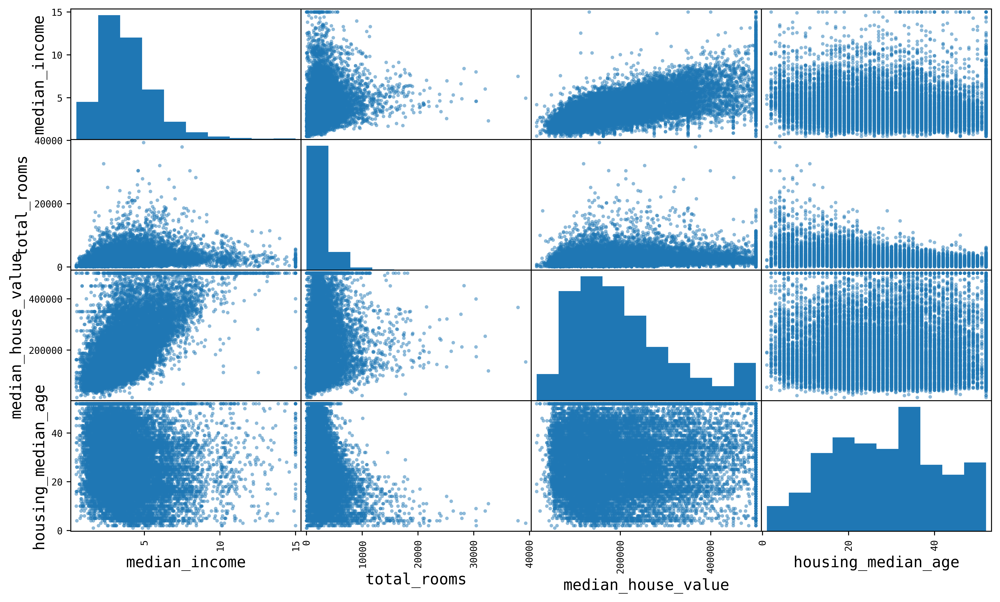

In [45]:
attr = ['median_income', 'total_rooms', 'median_house_value', 'housing_median_age']

scatter_matrix(housing_num[attr])

### **OBSERVATION - 4**

- median income remains the most correlated attributes

- there are quirkiness in the plot, and if not removed the model will learn this quirkiness
  
  - the plot indicates that there is an upper limit to *median_house_value* as *median_income* increases at $500k, ~$450k, ~$350, ~$280, ~$220k, ~$190, ~$170k, ~$140k. But this is untrue. 

> **NOTE: removing this datapoints will produce an even better model**

<Axes: xlabel='median_income', ylabel='median_house_value'>

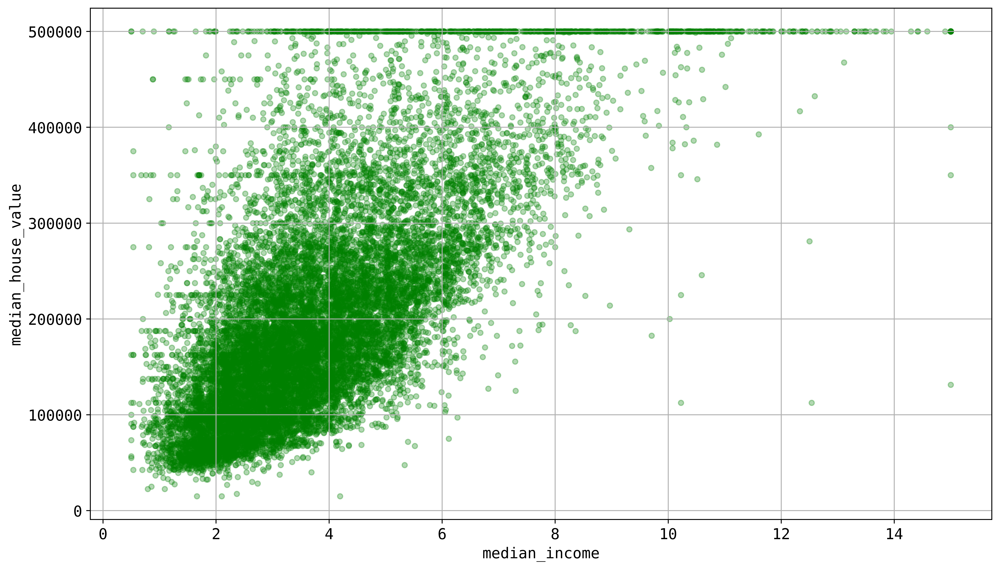

In [46]:
housing.plot(kind='scatter', y='median_house_value', x='median_income', alpha=0.3, color='green', grid=True)

### **EXPERIMENT WITH ATTRIBUTE COMBINATION**

Sometimes, combining attribute through mathematical transformation may produce a better correlation with the target values

In [47]:
# get the numerical attributes

housing_num.columns

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value', 'income_cat'],
      dtype='object')

In [48]:
# total room to bedroom ratio

housing_num['total_room_to_bedroom_ratio'] = housing_num['total_rooms'] / housing_num['total_bedrooms']

# total room per person
housing_num['room_to_person_ratio'] = housing_num['total_rooms'] / housing_num['households']

# house_value to bedrooms ratio

housing_num['bedrooms_to_household'] = housing_num['total_bedrooms'] / housing_num['households']

In [51]:
# compute the correlation matrix

corr_mat = housing_num.corr()

corr_mat['median_house_value'].sort_values(ascending=False)

median_house_value             1.000000
median_income                  0.688075
income_cat                     0.643892
total_room_to_bedroom_ratio    0.383920
room_to_person_ratio           0.151948
total_rooms                    0.134153
housing_median_age             0.105623
households                     0.065843
total_bedrooms                 0.049686
population                    -0.024650
longitude                     -0.045967
bedrooms_to_household         -0.046739
latitude                      -0.144160
Name: median_house_value, dtype: float64

#### **OBSERVATION - 5**

The combination yielded a better linear correlation than the stand alone attributes.For example, the ***total_room_to_bedroom_ratio*** yielded a better correlation than ***total_rooms*** or ***total_bedrooms***

## **PREPARING DATA FOR MACHINE LEARNING**

- get a copy of the data

- drop the target value

- Clean the data

In [52]:
# get a copy of the training set and drop the target attribute

# the drop method returns a copy of the dataframe/series
housing = train_set.drop("median_house_value", axis=1)

# get the label data
housing_labels = train_set["median_house_value"].copy()

In [53]:
# clean the data and transform missing values

housing.info()

<class 'pandas.core.frame.DataFrame'>
Index: 16512 entries, 13426 to 4985
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   longitude           16512 non-null  float64 
 1   latitude            16512 non-null  float64 
 2   housing_median_age  16512 non-null  float64 
 3   total_rooms         16512 non-null  float64 
 4   total_bedrooms      16344 non-null  float64 
 5   population          16512 non-null  float64 
 6   households          16512 non-null  float64 
 7   median_income       16512 non-null  float64 
 8   ocean_proximity     16512 non-null  object  
 9   income_cat          16512 non-null  category
dtypes: category(1), float64(8), object(1)
memory usage: 1.3+ MB


In [54]:
# replace the  missing values in total bedrooms with the median value

from sklearn.impute import SimpleImputer

imputer = SimpleImputer(strategy='median')

In [55]:
housing_num = housing.select_dtypes(include=[np.number])

**FIT** method will learn the value that will be used in each column; so that when the **TRANSFORM** is invoked, the ***learned values*** can be used in the dataset, wherever necessary.

In [56]:
# fit the training set to the estimator

imputer.fit(housing_num)

SimpleImputer(strategy='median')

In [57]:
X = imputer.transform(housing_num)

### **NOTE**

The **TRANSFORM** method, by default, will return a **Numpy** array instead of a **DataFrame**; this can be modified by setting the returned transformed values to a dataframe, or explicitly converting the result to a DataFrame, as shown below. 

In [58]:
X

array([[-1.1738e+02,  3.4200e+01,  1.6000e+01, ...,  3.1200e+02,
         7.6000e+01,  3.7578e+00],
       [-1.1976e+02,  3.6800e+01,  2.0000e+01, ...,  2.7950e+03,
         1.2670e+03,  2.2094e+00],
       [-1.2139e+02,  3.8640e+01,  3.3000e+01, ...,  6.5200e+02,
         2.2900e+02,  3.6937e+00],
       ...,
       [-1.1982e+02,  3.6830e+01,  1.6000e+01, ...,  1.0160e+03,
         3.7900e+02,  6.1175e+00],
       [-1.2181e+02,  3.8580e+01,  1.7000e+01, ...,  8.0800e+02,
         2.8600e+02,  5.9629e+00],
       [-1.1831e+02,  3.4000e+01,  5.2000e+01, ...,  9.3900e+02,
         2.7600e+02,  1.6892e+00]])

In [60]:
# convert the trained set X to a Dataframe

housing_trained = pd.DataFrame(X, columns=housing_num.columns, index=housing_num.index)

housing_trained.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income
13426,-117.38,34.20,16.0,193.0,45.0,312.0,76.0,3.7578
2292,-119.76,36.80,20.0,6257.0,1346.0,2795.0,1267.0,2.2094
12880,-121.39,38.64,33.0,1503.0,282.0,652.0,229.0,3.6937
1162,-121.52,39.51,30.0,3085.0,610.0,1688.0,575.0,2.3340
11578,-118.03,33.77,21.0,3803.0,898.0,1511.0,829.0,3.0000
